In [ ]:
pip install ipympl pandas matplotlib

In [2]:
# Enables interactive widgets in Jupyter
%matplotlib widget

import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.widgets import Slider
import numpy as np

def load_file(filename):
    # Added error handling for missing files
    try:
        return pd.read_csv(filename, encoding='utf-8-sig', on_bad_lines='skip')
    except FileNotFoundError:
        print(f"Error: {filename} not found. Please ensure the file exists.")
        return pd.DataFrame()

# 1. Load your data
results_df = load_file('results.csv')
limits_df = load_file('limits.csv')

if not results_df.empty and not limits_df.empty:
    print("Data loaded successfully.")

Data loaded successfully.


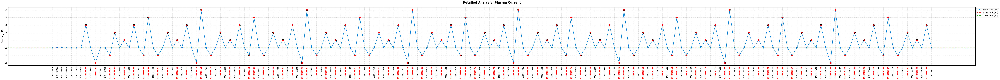

interactive(children=(Dropdown(description='Parameter:', options=('Plasma Current', 'Plasma Frequency', 'Plasm…

In [5]:
%matplotlib inline
import pandas as pd
import matplotlib.pyplot as plt
import ipywidgets as widgets
from ipywidgets import interact

def load_file(filename):
    try:
        return pd.read_csv(filename, encoding='utf-8-sig', on_bad_lines='skip')
    except Exception as e:
        print(f"Error: {e}")
        return pd.DataFrame()

# 1. Data Setup
results_df = load_file('results.csv')
limits_df = load_file('limits.csv')

# Pre-calculate Out-of-Spec parts for highlighting
results_with_limits = results_df.merge(
    limits_df[['param_name', 'Lower OK', 'Upper OK']], on='param_name', how='left'
)
results_with_limits['out_of_spec'] = (
    (results_with_limits['result'] < results_with_limits['Lower OK']) | 
    (results_with_limits['result'] > results_with_limits['Upper OK'])
)
out_of_spec_parts = set(results_with_limits.loc[results_with_limits['out_of_spec'], 'uniquepart_id'].astype(str))

# 2. Define the Plotting Function
def plot_parameter(param_name, show_outliers_only=False):
    data = results_df[results_df['param_name'] == param_name].copy().reset_index(drop=True)
    limit_row = limits_df[limits_df['param_name'] == param_name]
    
    if data.empty or limit_row.empty:
        print(f"No data or limits found for {param_name}")
        return

    low = limit_row['Lower OK'].values[0]
    high = limit_row['Upper OK'].values[0]
    
    if show_outliers_only:
        data = data[(data['result'] < low) | (data['result'] > high)]

    # Dynamic width based on data points
    fig_width = max(10, len(data) * 0.4)
    fig, ax = plt.subplots(figsize=(fig_width, 6))
    
    # Plot Trend
    ax.plot(data.index, data['result'], marker='o', color='#007acc', label='Measured Value', linewidth=1.5)
    
    # Limits & Shading
    ax.axhline(y=high, color='#d62728', linestyle='--', label=f'Upper Limit ({high})')
    ax.axhline(y=low, color='#2ca02c', linestyle='--', label=f'Lower Limit ({low})')
    ax.fill_between(data.index, low, high, color='#2ca02c', alpha=0.1)
    
    # Highlight Outliers
    outliers = data[(data['result'] < low) | (data['result'] > high)]
    ax.scatter(outliers.index, outliers['result'], color='red', s=80, edgecolors='black', zorder=5)

    # Formatting
    unit = data['unit'].iloc[0] if 'unit' in data.columns else "Value"
    ax.set_title(f"Detailed Analysis: {param_name}", fontsize=16, fontweight='bold', pad=20)
    ax.set_ylabel(f"Reading ({unit})", fontsize=12)
    ax.set_xticks(range(len(data)))
    ax.set_xticklabels(data['uniquepart_id'].astype(str), rotation=90, fontsize=9)
    
    # Color tick labels red if they are out of spec
    for tick in ax.get_xticklabels():
        if tick.get_text() in out_of_spec_parts:
            tick.set_color('red')
            tick.set_weight('bold')

    ax.grid(True, linestyle=':', alpha=0.6)
    ax.legend(loc='upper left', bbox_to_anchor=(1, 1))
    plt.tight_layout()
    plt.show()

# 3. Create the Interaction
param_dropdown = widgets.Dropdown(
    options=sorted(results_df['param_name'].unique()),
    description='Parameter:',
    disabled=False,
)

outlier_toggle = widgets.Checkbox(
    value=False,
    description='Show Outliers Only',
    disabled=False
)

interact(plot_parameter, param_name=param_dropdown, show_outliers_only=outlier_toggle);

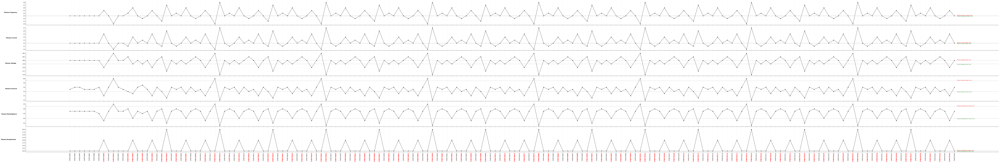

interactive(children=(FloatSlider(value=0.6, description='ID Gap:', max=1.5, min=0.3), Output()), _dom_classes…

In [8]:
%matplotlib widget
import pandas as pd
import matplotlib.pyplot as plt
import ipywidgets as widgets

# 1. Load Data
results_df = pd.read_csv('results.csv', encoding='utf-8-sig')
limits_df = pd.read_csv('limits.csv', encoding='utf-8-sig')

# 2. Identify "Global" NOK Parts
# A part is red if it fails ANY parameter check
results_with_limits = results_df.merge(
    limits_df[['param_name', 'Lower OK', 'Upper OK']], on='param_name', how='left'
)
results_with_limits['is_nok'] = (
    (results_with_limits['result'] < results_with_limits['Lower OK']) | 
    (results_with_limits['result'] > results_with_limits['Upper OK'])
)
nok_part_ids = set(results_with_limits.loc[results_with_limits['is_nok'], 'uniquepart_id'].astype(str))

# 3. Plotting Function
def draw_stacked_chart(gap_size=0.5):
    plt.close('all')
    parameters = limits_df['param_name'].unique()
    num_params = len(parameters)
    unique_ids = results_df[results_df['param_name'] == parameters[0]]['uniquepart_id'].astype(str).tolist()
    
    # "Proper Gap" Logic: Width scales with the number of parts
    # 0.5 inches per ID provides a very clear, readable gap
    total_width = max(12, len(unique_ids) * gap_size)
    fig, axes = plt.subplots(num_params, 1, figsize=(total_width, 3 * num_params), sharex=True)
    
    if num_params == 1: axes = [axes]

    for i, param in enumerate(parameters):
        ax = axes[i]
        data = results_df[results_df['param_name'] == param].reset_index(drop=True)
        low = limits_df.loc[limits_df['param_name'] == param, 'Lower OK'].values[0]
        high = limits_df.loc[limits_df['param_name'] == param, 'Upper OK'].values[0]

        # Draw the "Sketch" Style: Lines and Points
        ax.plot(data.index, data['result'], marker='o', color='black', linewidth=1, markersize=4)
        
        # Upper and Lower Limit Lines (Labelled on the right like your drawing)
        ax.axhline(y=high, color='gray', linestyle='--', alpha=0.5)
        ax.axhline(y=low, color='gray', linestyle='--', alpha=0.5)
        ax.text(len(data)-0.5, high, f' {param} Upper Limit', verticalalignment='bottom', fontsize=8, color='red')
        ax.text(len(data)-0.5, low, f' {param} Lower Limit', verticalalignment='top', fontsize=8, color='green')

        # Formatting
        ax.set_ylabel(param, fontweight='bold', rotation=0, labelpad=50, ha='right')
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.grid(axis='x', linestyle=':', alpha=0.3)

    # Final X-Axis Formatting
    last_ax = axes[-1]
    last_ax.set_xticks(range(len(unique_ids)))
    last_ax.set_xticklabels(unique_ids, rotation=90)
    
    # Color Part IDs Red if NOK
    for tick_label in last_ax.get_xticklabels():
        if tick_label.get_text() in nok_part_ids:
            tick_label.set_color('red')
            tick_label.set_weight('bold')
    
    plt.tight_layout()
    plt.show()

# 4. Interactive Gap Control
widgets.interact(draw_stacked_chart, gap_size=widgets.FloatSlider(value=0.6, min=0.3, max=1.5, step=0.1, description='ID Gap:'));

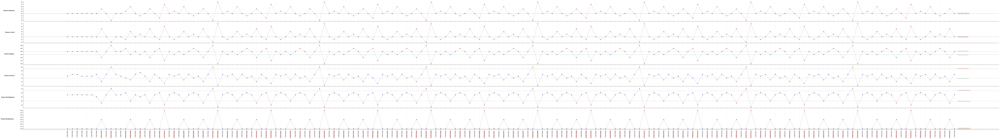

interactive(children=(FloatSlider(value=0.7, description='Spacing:', max=2.0, min=0.4), Output()), _dom_classe…

In [9]:
%matplotlib widget
import pandas as pd
import matplotlib.pyplot as plt
import ipywidgets as widgets

# 1. Load Data
# Assuming 'results.csv' and 'limits.csv' are in the same folder
results_df = pd.read_csv('results.csv', encoding='utf-8-sig')
limits_df = pd.read_csv('limits.csv', encoding='utf-8-sig')

# 2. Identify "Global" NOK Parts
# A part ID is marked red if it is outside limits in ANY parameter
results_with_limits = results_df.merge(
    limits_df[['param_name', 'Lower OK', 'Upper OK']], on='param_name', how='left'
)
results_with_limits['is_nok'] = (
    (results_with_limits['result'] < results_with_limits['Lower OK']) | 
    (results_with_limits['result'] > results_with_limits['Upper OK'])
)
nok_part_ids = set(results_with_limits.loc[results_with_limits['is_nok'], 'uniquepart_id'].astype(str))

# 3. Plotting Function
def draw_stacked_chart(gap_size=0.6):
    plt.close('all')
    parameters = limits_df['param_name'].unique()
    num_params = len(parameters)
    
    # Get unique part IDs in order
    unique_ids = results_df[results_df['param_name'] == parameters[0]]['uniquepart_id'].astype(str).tolist()
    
    # Proper Gap Logic: Width scales with the number of parts
    total_width = max(12, len(unique_ids) * gap_size)
    fig, axes = plt.subplots(num_params, 1, figsize=(total_width, 3 * num_params), sharex=True)
    
    # Handle single parameter case
    if num_params == 1: axes = [axes]

    for i, param in enumerate(parameters):
        ax = axes[i]
        data = results_df[results_df['param_name'] == param].reset_index(drop=True)
        low = limits_df.loc[limits_df['param_name'] == param, 'Lower OK'].values[0]
        high = limits_df.loc[limits_df['param_name'] == param, 'Upper OK'].values[0]

        # Determine color for each dot: Blue if in-spec (under/within threshold), Red if out-of-spec
        point_colors = ['blue' if (low <= val <= high) else 'red' for val in data['result']]

        # Draw the Trend Line (Gray to make the colored dots stand out)
        ax.plot(data.index, data['result'], color='black', linewidth=1, alpha=0.3, zorder=1)
        
        # Draw the Dots with conditional coloring
        ax.scatter(data.index, data['result'], c=point_colors, s=40, edgecolors='white', linewidth=0.5, zorder=2)
        
        # Upper and Lower Limit Lines (Labelled on the right as per your sketch)
        ax.axhline(y=high, color='red', linestyle='--', alpha=0.4, linewidth=1)
        ax.axhline(y=low, color='green', linestyle='--', alpha=0.4, linewidth=1)
        
        # Add text labels for limits on the far right
        ax.text(len(data)-0.4, high, f' {param} Upper Limit', va='bottom', fontsize=7, color='red', alpha=0.7)
        ax.text(len(data)-0.4, low, f' {param} Lower Limit', va='top', fontsize=7, color='green', alpha=0.7)

        # Formatting
        ax.set_ylabel(param, fontweight='bold', rotation=0, labelpad=60, ha='right')
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.grid(axis='x', linestyle=':', alpha=0.3)

    # Final X-Axis Formatting
    last_ax = axes[-1]
    last_ax.set_xticks(range(len(unique_ids)))
    last_ax.set_xticklabels(unique_ids, rotation=90)
    
    # Color Part IDs Red if they failed ANY parameter
    for tick_label in last_ax.get_xticklabels():
        if tick_label.get_text() in nok_part_ids:
            tick_label.set_color('red')
            tick_label.set_weight('bold')
    
    plt.tight_layout()
    plt.show()

# 4. Interactive Gap Control
widgets.interact(draw_stacked_chart, gap_size=widgets.FloatSlider(
    value=0.7, min=0.4, max=2.0, step=0.1, description='Spacing:'));

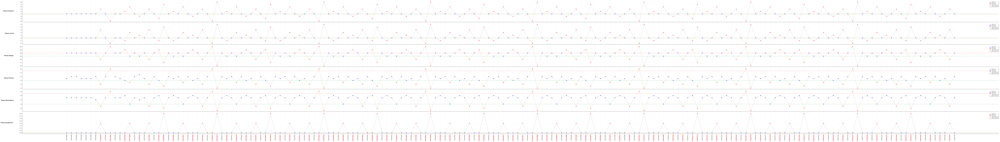

interactive(children=(FloatSlider(value=0.8, description='Spacing:', max=2.0, min=0.5), Output()), _dom_classe…

In [12]:
%matplotlib widget
import pandas as pd
import matplotlib.pyplot as plt
import ipywidgets as widgets
from matplotlib.lines import Line2D

# 1. Load Data
results_df = pd.read_csv('results.csv', encoding='utf-8-sig')
limits_df = pd.read_csv('limits.csv', encoding='utf-8-sig')

# 2. Identify "Global" NOK Parts
results_with_limits = results_df.merge(
    limits_df[['param_name', 'Lower OK', 'Upper OK']], on='param_name', how='left'
)
results_with_limits['is_nok'] = (
    (results_with_limits['result'] < results_with_limits['Lower OK']) | 
    (results_with_limits['result'] > results_with_limits['Upper OK'])
)
nok_part_ids = set(results_with_limits.loc[results_with_limits['is_nok'], 'uniquepart_id'].astype(str))

# 3. Plotting Function
def draw_stacked_chart(gap_size=0.7):
    plt.close('all')
    parameters = limits_df['param_name'].unique()
    num_params = len(parameters)
    unique_ids = results_df[results_df['param_name'] == parameters[0]]['uniquepart_id'].astype(str).tolist()
    
    total_width = max(14, len(unique_ids) * gap_size)
    fig, axes = plt.subplots(num_params, 1, figsize=(total_width, 3.5 * num_params), sharex=True)
    
    if num_params == 1: axes = [axes]

    # Custom Legend Elements
    legend_elements = [
        Line2D([0], [0], color='black', alpha=0.3, lw=1, label='Trend Line'),
        Line2D([0], [0], marker='o', color='w', markerfacecolor='blue', markersize=8, label='Within Limits'),
        Line2D([0], [0], marker='o', color='w', markerfacecolor='red', markersize=8, label='Out of Spec'),
        Line2D([0], [0], color='red', lw=1, linestyle='--', label='Upper Limit (USL)'),
        Line2D([0], [0], color='green', lw=1, linestyle='--', label='Lower Limit (LSL)')
    ]

    for i, param in enumerate(parameters):
        ax = axes[i]
        data = results_df[results_df['param_name'] == param].reset_index(drop=True)
        low = limits_df.loc[limits_df['param_name'] == param, 'Lower OK'].values[0]
        high = limits_df.loc[limits_df['param_name'] == param, 'Upper OK'].values[0]

        # Coloring logic
        point_colors = ['blue' if (low <= val <= high) else 'red' for val in data['result']]

        # Plotting
        ax.plot(data.index, data['result'], color='black', linewidth=1, alpha=0.3, zorder=1)
        ax.scatter(data.index, data['result'], c=point_colors, s=50, edgecolors='white', linewidth=0.5, zorder=2)
        
        # Limit Lines
        ax.axhline(y=high, color='red', linestyle='--', alpha=0.5, linewidth=1.5)
        ax.axhline(y=low, color='green', linestyle='--', alpha=0.5, linewidth=1.5)
        
        # Legend for each parameter (Top Right)
        ax.legend(handles=legend_elements, loc='upper right', fontsize=8, frameon=True, shadow=True)

        # Labels & Aesthetics
        ax.set_ylabel(f"{param}", fontweight='bold', rotation=0, labelpad=70, ha='right', fontsize=11)
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.grid(axis='x', linestyle=':', alpha=0.4)

    # Final X-Axis Formatting
    last_ax = axes[-1]
    last_ax.set_xticks(range(len(unique_ids)))
    last_ax.set_xticklabels(unique_ids, rotation=90)
    
    for tick_label in last_ax.get_xticklabels():
        if tick_label.get_text() in nok_part_ids:
            tick_label.set_color('red')
            tick_label.set_weight('bold')
    
    plt.tight_layout()
    plt.show()

# 4. Interactive Display
widgets.interact(draw_stacked_chart, gap_size=widgets.FloatSlider(
    value=0.8, min=0.5, max=2.0, step=0.1, description='Spacing:'));

In [17]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio

# Set renderer to 'notebook' or 'iframe' for Jupyter
pio.renderers.default = 'notebook' 

# 1. Load and Clean Data
results_df = pd.read_csv('results.csv', encoding='utf-8-sig').apply(lambda x: x.str.strip() if x.dtype == "object" else x)
limits_df = pd.read_csv('limits.csv', encoding='utf-8-sig').apply(lambda x: x.str.strip() if x.dtype == "object" else x)

parameters = limits_df['param_name'].unique()
num_params = len(parameters)

# Identify NOK parts globally
results_with_limits = results_df.merge(
    limits_df[['param_name', 'Lower OK', 'Upper OK']], on='param_name', how='left'
)
results_with_limits['is_nok'] = (
    (results_with_limits['result'] < results_with_limits['Lower OK']) | 
    (results_with_limits['result'] > results_with_limits['Upper OK'])
)
nok_parts = set(results_with_limits.loc[results_with_limits['is_nok'], 'uniquepart_id'].astype(str))

# 2. Setup Subplots
fig = make_subplots(
    rows=num_params, cols=1, 
    shared_xaxes=True, 
    vertical_spacing=0.04,
    subplot_titles=[f"<b>{p}</b>" for p in parameters]
)

# 3. Add Traces
for i, param in enumerate(parameters):
    data = results_df[results_df['param_name'] == param].reset_index(drop=True)
    low = limits_df.loc[limits_df['param_name'] == param, 'Lower OK'].values[0]
    high = limits_df.loc[limits_df['param_name'] == param, 'Upper OK'].values[0]
    
    # Dot colors
    colors = ['blue' if (low <= val <= high) else 'red' for val in data['result']]
    
    # Line
    fig.add_trace(go.Scatter(
        x=data['uniquepart_id'].astype(str), y=data['result'],
        mode='lines', line=dict(color='rgba(0,0,0,0.2)', width=1),
        showlegend=False, hoverinfo='skip'
    ), row=i+1, col=1)

    # Markers (Legend enabled for the first row only to avoid duplicates)
    fig.add_trace(go.Scatter(
        x=data['uniquepart_id'].astype(str), y=data['result'],
        mode='markers',
        marker=dict(color=colors, size=8, line=dict(width=1, color='white')),
        name='Measurement',
        hovertemplate="<b>Part ID:</b> %{x}<br><b>Value:</b> %{y:.3f}<extra></extra>",
        showlegend=(i == 0)
    ), row=i+1, col=1)

    # Threshold Lines
    fig.add_hline(y=high, line_dash="dash", line_color="red", row=i+1, col=1, 
                 annotation_text="USL", annotation_position="top right")
    fig.add_hline(y=low, line_dash="dash", line_color="green", row=i+1, col=1, 
                 annotation_text="LSL", annotation_position="bottom right")

# 4. Color NOK Part IDs (X-Axis Customization)
# We add a dummy trace to show 'OK' vs 'NOK' in the legend
fig.add_trace(go.Scatter(x=[None], y=[None], mode='markers', marker=dict(color='blue'), name='OK (In Limits)'))
fig.add_trace(go.Scatter(x=[None], y=[None], mode='markers', marker=dict(color='red'), name='NOK (Out of Spec)'))

# 5. Layout and Interactive Hover
fig.update_layout(
    height=300 * num_params,
    template="plotly_white",
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1),
    hovermode="x unified", # Shows all parameter values for a part at once
    title="Process Quality Control Dashboard"
)

fig.update_xaxes(tickangle=90)

# Optional: Adding red tick labels via annotations is heavy; 
# The "x unified" hover mode makes it obvious which Part ID is selected across all charts.
fig.show()

In [21]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio

pio.renderers.default = 'notebook' 

# 1. Load and Force Standard Formatting
results_df = pd.read_csv('results.csv', encoding='utf-8-sig')
limits_df = pd.read_csv('limits.csv', encoding='utf-8-sig')

# Clean 'param_name' - Force Uppercase and Strip Spaces
results_df['param_name'] = results_df['param_name'].astype(str).str.strip().str.upper()
limits_df['param_name'] = limits_df['param_name'].astype(str).str.strip().str.upper()

# Clean 'uniquepart_id' - Force String and Strip Spaces
results_df['uniquepart_id'] = results_df['uniquepart_id'].astype(str).str.strip()

# 2. Identify Unique Parameters
parameters = limits_df['param_name'].unique()
num_params = len(parameters)

# 3. Create Subplots
fig = make_subplots(
    rows=num_params, cols=1, 
    shared_xaxes=True, 
    vertical_spacing=0.05,
    subplot_titles=[f"<b>{p}</b>" for p in parameters]
)

# 4. Add Traces with Data Validation
for i, param in enumerate(parameters):
    # Filter data for this parameter
    data = results_df[results_df['param_name'] == param].copy().reset_index(drop=True)
    
    # If no data is found, add an annotation so you know why the graph is empty
    if data.empty:
        fig.add_annotation(text=f"ERROR: No data found for '{param}'", 
                           xref="paper", yref="paper", x=0.5, y=1-(i/num_params), showarrow=False)
        continue
    
    low = limits_df.loc[limits_df['param_name'] == param, 'Lower OK'].values[0]
    high = limits_df.loc[limits_df['param_name'] == param, 'Upper OK'].values[0]
    
    colors = ['blue' if (low <= val <= high) else 'red' for val in data['result']]
    
    # Trend Line + Dots
    fig.add_trace(go.Scatter(
        x=data['uniquepart_id'], 
        y=data['result'],
        mode='lines+markers',
        line=dict(color='rgba(0,0,0,0.2)', width=1),
        marker=dict(color=colors, size=8, line=dict(width=1, color='white')),
        name=param,
        hovertemplate="<b>Part ID:</b> %{x}<br><b>Value:</b> %{y:.3f}<extra></extra>",
        showlegend=False
    ), row=i+1, col=1)

    # USL / LSL Lines
    fig.add_hline(y=high, line_dash="dash", line_color="red", row=i+1, col=1, annotation_text="USL")
    fig.add_hline(y=low, line_dash="dash", line_color="green", row=i+1, col=1, annotation_text="LSL")

# 5. Legend and Layout
fig.add_trace(go.Scatter(x=[None], y=[None], mode='markers', marker=dict(color='blue'), name='OK'))
fig.add_trace(go.Scatter(x=[None], y=[None], mode='markers', marker=dict(color='red'), name='NOK'))

fig.update_layout(height=250 * num_params, template="plotly_white", hovermode="x unified")
fig.update_xaxes(tickangle=90, type='category') # 'category' forces IDs to be treated as labels

fig.show()